This script clusters the different features and representations exported from .feature_extraction.ipynb.

1) Nearest neighbour graphs of all representations are created based on euclidian distance
2) Embeddings are created using **UMAP** and **Hopkins** statistic computed for each embeddings- and original feature space
3) The following three clustering algorithms are applied:
    - **kMeans**
    - **HDBSCAN**
    - **Leiden**
4) All resulting clusterings are evaluated with
    - **silhouette score**
    - **V-measure**

In [50]:
from copy import deepcopy
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import json
import random
from tqdm.auto import tqdm
import itertools

import umap
from umap.umap_ import nearest_neighbors
import hdbscan
import leidenalg as la
import igraph as ig

from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from sklearn.preprocessing import LabelEncoder

from utils import plotting, clustering
import pickle

In [51]:
inner = {
    "dataset": [],
    "nn_graph": {},
    "embeddings": [],
    "kMeans": [],
    "kMeans-preset": [],
    "HDBSCAN": [],
    "Leiden": [],    
    "Modularity": []
    }

In [52]:
clusters_dict = {
    "true_labels": [],
    "PAFs": deepcopy(inner),
    "LFCCs": deepcopy(inner),
    "Spectrograms": deepcopy(inner),
    "VAE representations": deepcopy(inner),
    }

In [53]:
RANDOM_SEED = 42
random.seed(RANDOM_SEED)
np.random.RandomState(RANDOM_SEED)

# for permutations
random_seeds = np.random.randint(0, 1000, 10)
print(random_seeds)


SUBSET_SIZE = 200 # size of random subset per class
N_NEIGHBORS = 15 # for nearest neighbors graph
DISTANCE_METRIC = "euclidean"

[387 600 315  13 241 776 345 564 897 339]


In [54]:
# List of titles for plots of PAFs
feature_titles_list = [
    "Duration [s]",
    "Temporal 1st Quartile [s]", 
    "Temporal Median [s]", 
    "Temporal 3rd Quartile [s]", 
    "Temporal Standard Deviation [s]", 
    "Temporal Skewness", 
    "Temporal Kurtosis", 
    "Temporal Entropy", 
    "Mean Frequency [kHz]",
    "Mean Peak Frequency [kHz]",
    "Spectral Sandard Deviation [kHz]",
    "Spectral Flatness", 
    "Frequency 1st Quartile [kHz]",
    "Frequency Median [kHz]", 
    "Frequency 3rd Quartile [kHz]", 
    "Mean Dominant Frequency [kHz]", 
    "Min Dominant Frequency [kHz]",
    "Max Dominant Frequency [kHz]", 
    "Dominant Frequency Range [kHz]", 
    "Dominant Frequency Modulation [kHz]", 
    "Spectral Entropy", 
    "Harmonics-to-Noise Ratio [dB]",
    "Spectrographic Entropy"
    ]

# List of column names of PAFs
feature_columns_list = [
    "duration",
    "t_q1", 
    "t_median", 
    "t_q3", 
    "std_t", 
    "skew_t", 
    "kurt_t", 
    "t_entropy", 
    "mean_f",
    "mean_peak_f", 
    "std_f",
    "flatness_s", 
    "f_q1",
    "f_median", 
    "f_q3", 
    "mean_dom", 
    "min_dom",
    "max_dom", 
    "range_dom", 
    "mod_dom", 
    "pse", 
    "hnr",
    "spectrographic_entropy"
    ]

## Import data

In [55]:
calls_df = pd.read_csv('pickles/features_and_spectrograms.csv')
calls_df['log_padded_spectrogram'] = calls_df['log_padded_spectrogram'].apply(lambda x: np.array(json.loads(x)))
calls_df['log_padded_log_freq_spectrogram'] = calls_df['log_padded_log_freq_spectrogram'].apply(lambda x: np.array(json.loads(x)))
calls_df['log_padded_lfccs'] = calls_df['log_padded_lfccs'].apply(lambda x: np.asarray(json.loads(x)))

In [56]:
# import latent reps from VAE and merge with calls df
representations_df = pd.read_csv("pickles/latent_representations_CVAE.csv")
representations_df["latent_representation"] = representations_df["latent_representation"].apply(lambda x: np.asarray(json.loads(x)))
calls_df = pd.merge(calls_df, representations_df, on="clip_ID")
calls_df = calls_df.drop(columns=["call_type_y"])
calls_df = calls_df.rename(columns={"call_type_x": "call_type"})

In [57]:
print(len(calls_df[calls_df.isna().any(axis=1)]))
calls_df = calls_df.dropna()
calls_df.info()

0
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7282 entries, 0 to 7281
Data columns (total 38 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   track_ID                         7282 non-null   object 
 1   clip_ID                          7282 non-null   object 
 2   goose_ID                         7282 non-null   object 
 3   call_type                        7282 non-null   object 
 4   waveform                         7282 non-null   object 
 5   sr                               7282 non-null   int64  
 6   filepath                         7282 non-null   object 
 7   log_scaled_spectrogram           7282 non-null   object 
 8   lfccs                            7282 non-null   object 
 9   peak                             7282 non-null   float64
 10  duration                         7282 non-null   float64
 11  log_padded_spectrogram           7282 non-null   object 
 12  log_padded_log_fre

/var/folders/kl/qgqbw3bd42bf_tybhvnz9vxh0000gn/T/ipykernel_50279/1510808998.py:4: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  hist = sns.histplot(


[]

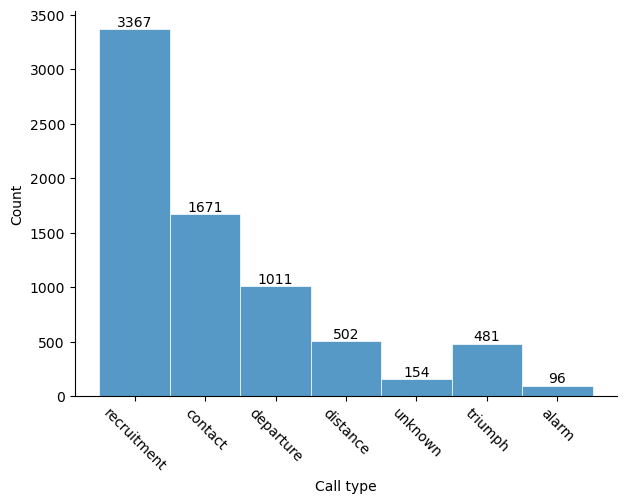

In [58]:
f, ax = plt.subplots(figsize=(7, 5))
sns.despine(f)

hist = sns.histplot(
    calls_df,
    x="call_type",
    multiple="stack",
    palette="viridis",
    edgecolor="1",
    linewidth=.5,
)

plt.xticks(rotation=-45)
ax.set_xlabel("Call type")

# Add counts
for p in hist.patches:
    height = p.get_height()
    x = p.get_x() + p.get_width() / 2
    ax.annotate(f'{int(height)}', (x, height), ha='center', va='bottom')
    
plt.plot()

Only keep a random subset of recruitment, departure and contact calls to balance the dataset and prevent overcrowding the visualizations.

In [59]:
subsample_sizes = {
    'recruitment': SUBSET_SIZE,
    'contact': SUBSET_SIZE,
    'departure': SUBSET_SIZE,
    'distance': SUBSET_SIZE,
    'triumph': SUBSET_SIZE,
    'unknown': 0,
}

# Randomly subsample per call type
def subsample_group(group):
    call_type = group.name  # Group name corresponds to call type
    if call_type in subsample_sizes:
        return group.sample(n=subsample_sizes[call_type], random_state=42)
    return group  # Return untouched if no subsampling is needed

# Group by type and apply subsampling
calls_df = calls_df.groupby('call_type', group_keys=False).apply(subsample_group)

/var/folders/kl/qgqbw3bd42bf_tybhvnz9vxh0000gn/T/ipykernel_50279/1806227382.py:18: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  calls_df = calls_df.groupby('call_type', group_keys=False).apply(subsample_group)


/var/folders/kl/qgqbw3bd42bf_tybhvnz9vxh0000gn/T/ipykernel_50279/1510808998.py:4: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  hist = sns.histplot(


[]

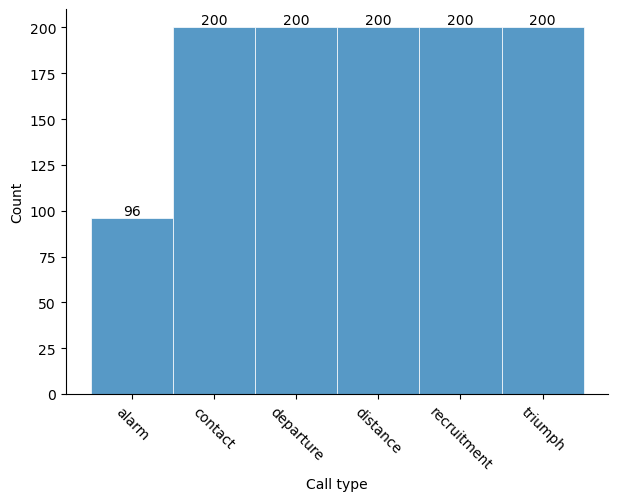

In [60]:
f, ax = plt.subplots(figsize=(7, 5))
sns.despine(f)

hist = sns.histplot(
    calls_df,
    x="call_type",
    multiple="stack",
    palette="viridis",
    edgecolor="1",
    linewidth=.5,
)

plt.xticks(rotation=-45)
ax.set_xlabel("Call type")

# Add counts
for p in hist.patches:
    height = p.get_height()
    x = p.get_x() + p.get_width() / 2
    ax.annotate(f'{int(height)}', (x, height), ha='center', va='bottom')
    
plt.plot()

In [61]:
le = LabelEncoder()
le.fit(calls_df["call_type"])
calls_df["encoded_call_type"] = le.transform(calls_df["call_type"])
clusters_dict["true_labels"] = np.asarray(calls_df["encoded_call_type"])

#### Load representation arrays

In [62]:
# considering scaling: https://github.com/lmcinnes/umap/issues/66

In [63]:
paf_scaled = StandardScaler().fit_transform(calls_df.drop(columns=["call_type", "track_ID", "clip_ID", "goose_ID", "waveform", "sr", "filepath", "log_scaled_spectrogram", "log_padded_spectrogram", "log_padded_log_freq_spectrogram", "lfccs", "log_padded_lfccs", "latent_representation", "duration_paf"]))

In [64]:
def create_representations_subdf_and_scale(full_df, column_name, column_names=["call_type", "track_ID", "goose_ID"]):
    column_names_new_df = column_names.copy()
    subset_list = []
    for idx, row in full_df.iterrows():
        subset_list.append([row["call_type"], row["track_ID"], row["goose_ID"], *row[column_name].flatten()])

    for i in range(len(full_df.iloc[0][column_name].flatten())):
        column_names_new_df.append(i)

    subset_df = pd.DataFrame(subset_list, columns=column_names_new_df, index=None)
    subset_df.head()

    subset_scaled = StandardScaler().fit_transform(subset_df.drop(columns=column_names))

    return subset_scaled, subset_df

In [65]:
lfccs_scaled, lfccs_df = create_representations_subdf_and_scale(calls_df, "log_padded_lfccs", column_names=["call_type", "track_ID", "goose_ID"])
lfccs_df.head()

,call_type,track_ID,goose_ID,0,1,2,3,4,5,6,...,7094,7095,7096,7097,7098,7099,7100,7101,7102,7103
0,alarm,GT00052,Dagobert,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,alarm,GT00058,Besenstiel,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,alarm,GT00055,Lausbursch,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,alarm,GT00989,unknown,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,alarm,GT00053,Dagobert,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [66]:
spectrograms_scaled, spectrograms_df = create_representations_subdf_and_scale(calls_df, "log_padded_spectrogram", column_names=["call_type", "track_ID", "goose_ID"])
spectrograms_df.head()

,call_type,track_ID,goose_ID,0,1,2,3,4,5,6,...,7470,7471,7472,7473,7474,7475,7476,7477,7478,7479
0,alarm,GT00052,Dagobert,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,alarm,GT00058,Besenstiel,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,alarm,GT00055,Lausbursch,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,alarm,GT00989,unknown,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,alarm,GT00053,Dagobert,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [67]:
_, vae_df = create_representations_subdf_and_scale(calls_df, "latent_representation", column_names=["call_type", "track_ID", "goose_ID"])
vae_df.head()

,call_type,track_ID,goose_ID,0,1,2,3,4,5,6,...,118,119,120,121,122,123,124,125,126,127
0,alarm,GT00052,Dagobert,-0.996120,-1.293491,-0.274241,-1.699560,0.150364,-2.525295,-4.055036,...,0.187793,1.979131,-0.025080,0.041803,-0.396895,0.464765,-2.530157,-0.257056,2.345959,0.193689
1,alarm,GT00058,Besenstiel,0.180914,-1.087070,0.535040,-1.757507,0.077656,-1.186059,-4.327238,...,1.006600,2.038521,-0.930883,-0.093940,-1.694600,-1.657280,-2.004178,-1.057245,1.895922,-0.211365
2,alarm,GT00055,Lausbursch,0.405581,-1.469653,0.696128,-1.176616,-0.559880,-0.873234,-3.860662,...,1.021042,2.254803,-0.553970,-0.431311,-2.243304,-0.913476,-1.340884,-0.952553,2.036332,-0.678484
3,alarm,GT00989,unknown,0.334676,-1.090227,0.725884,-0.737065,-0.943948,-1.322740,-2.870980,...,0.222723,0.407143,-0.876689,-0.544619,-0.931471,-1.914407,-1.591332,0.246069,1.628715,0.760741
4,alarm,GT00053,Dagobert,-0.730971,-0.860086,0.140247,-0.820309,0.238559,-2.412960,-3.867813,...,0.130198,1.836507,-0.732536,-0.314792,-0.438377,-0.714435,-3.016155,-1.106565,1.502295,0.186847


# Cluster and validate the different represenations

## NN Graphs and UMAP embeddings

#### Embed predefined audio features

In [68]:
nn_results_paf = nearest_neighbors(
    paf_scaled,
    n_neighbors=N_NEIGHBORS,
    metric=DISTANCE_METRIC,
    metric_kwds={},
    angular=False,
    random_state=RANDOM_SEED,
    verbose=True,
)

clusters_dict["PAFs"]["nn_graph"] = nn_results_paf

Thu Jan 30 12:16:56 2025 Finding Nearest Neighbors
Thu Jan 30 12:16:56 2025 Building RP forest with 7 trees
Thu Jan 30 12:16:56 2025 NN descent for 10 iterations
	 1  /  10
	 2  /  10
	 3  /  10
	Stopping threshold met -- exiting after 3 iterations
Thu Jan 30 12:16:56 2025 Finished Nearest Neighbor Search


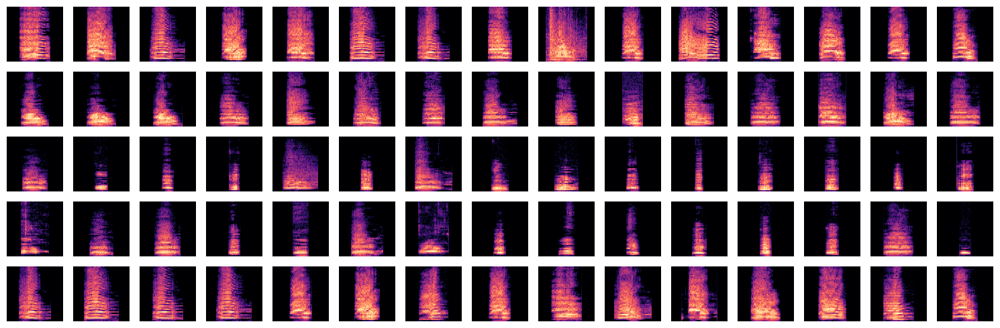

In [69]:
plotting.display_nearest_neighbours(nn_results_paf, calls_df)

In [70]:
embeddings_paf = umap.UMAP(precomputed_knn=nn_results_paf, n_neighbors=15, n_components=2, min_dist=0.1, random_state=RANDOM_SEED).fit_transform(paf_scaled)
clusters_dict["PAFs"]["embeddings"] = embeddings_paf

/Users/lenagies/anaconda3/envs/goose_vocalizations/lib/python3.11/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


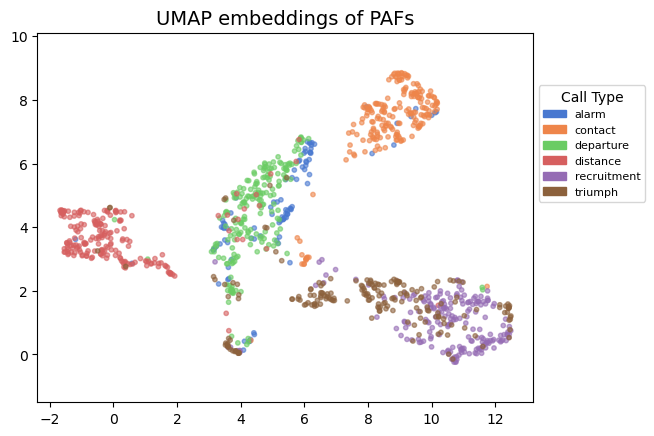

In [71]:
plotting.plot_embeddings_with_colorcoded_label(calls_df, embeddings_paf, "call_type", "UMAP embeddings of PAFs", "Call Type")

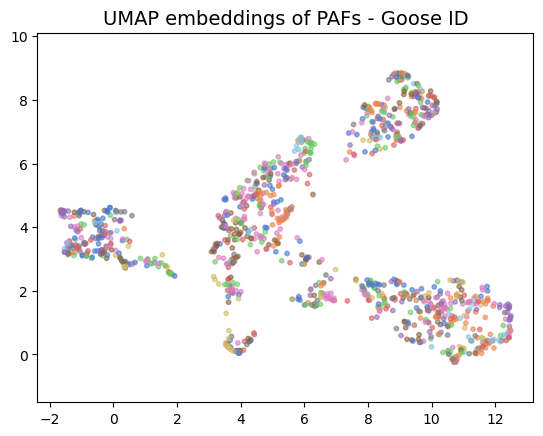

In [72]:
plotting.plot_embeddings_with_colorcoded_label(calls_df, embeddings_paf, "goose_ID", "UMAP embeddings of PAFs - Goose ID", show_legend=False)

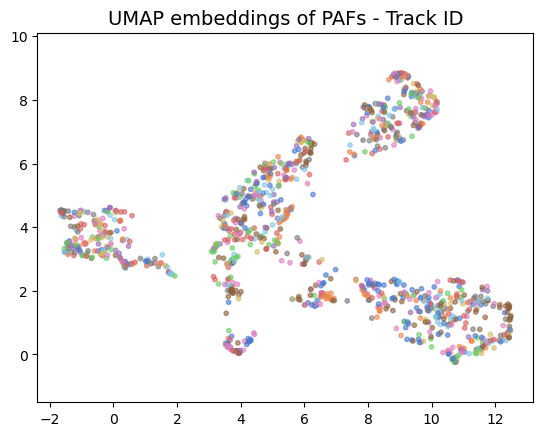

In [73]:
plotting.plot_embeddings_with_colorcoded_label(calls_df, embeddings_paf, "track_ID", "UMAP embeddings of PAFs - Track ID", show_legend=False)

/Users/lenagies/Desktop/Master/Thesis/geese/code/GooseVocalizations/utils/plotting.py:436: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(


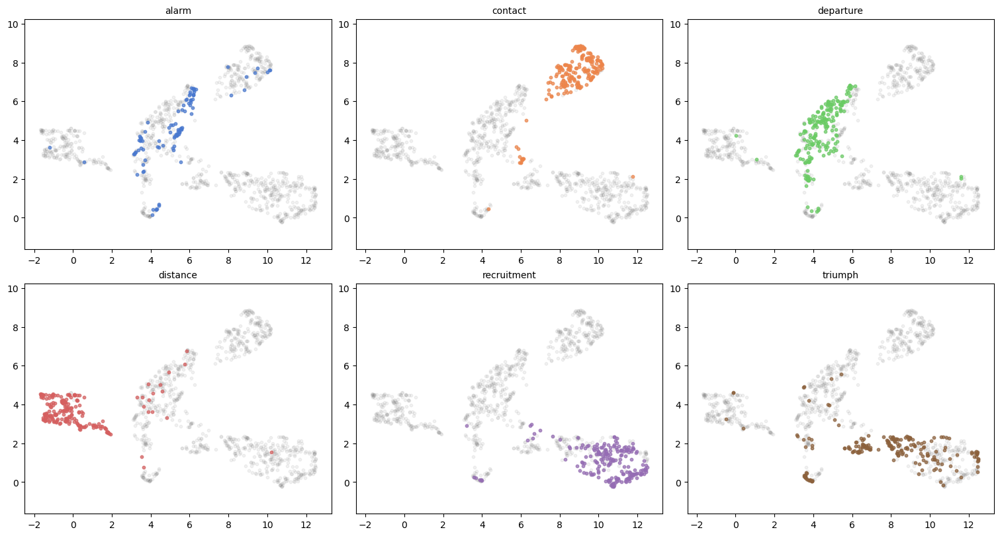

In [74]:
plotting.plot_embedding_per_call_type(embeddings_paf, calls_df)

#### Embed LFCCs

In [75]:
nn_results_lfcc = nearest_neighbors(
    lfccs_scaled,
    n_neighbors=N_NEIGHBORS,
    metric=DISTANCE_METRIC,
    metric_kwds={},
    angular=False,
    random_state=RANDOM_SEED,
    verbose=True,
)
clusters_dict["LFCCs"]["nn_graph"] = nn_results_lfcc

Thu Jan 30 12:17:04 2025 Finding Nearest Neighbors
Thu Jan 30 12:17:04 2025 Building RP forest with 7 trees
Thu Jan 30 12:17:04 2025 NN descent for 10 iterations
	 1  /  10
	 2  /  10
	 3  /  10
	Stopping threshold met -- exiting after 3 iterations
Thu Jan 30 12:17:05 2025 Finished Nearest Neighbor Search


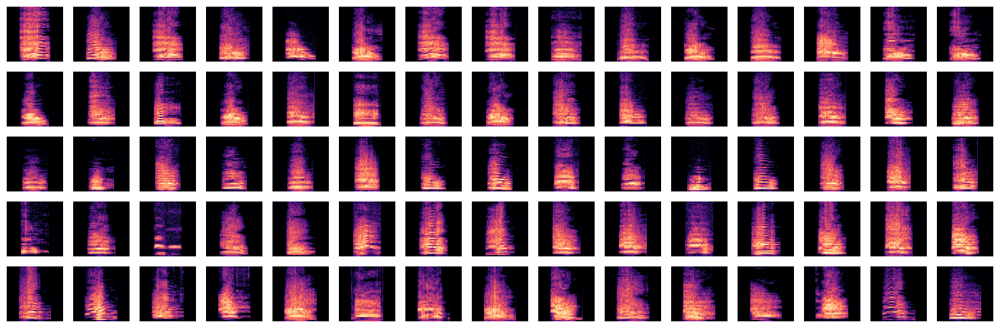

In [76]:
plotting.display_nearest_neighbours(nn_results_lfcc, calls_df)

In [77]:
embeddings_lfcc = umap.UMAP(precomputed_knn=nn_results_lfcc, n_neighbors=N_NEIGHBORS, n_components=2, min_dist=0.1, random_state=RANDOM_SEED).fit_transform(lfccs_scaled)
clusters_dict["LFCCs"]["embeddings"] = embeddings_lfcc

/Users/lenagies/anaconda3/envs/goose_vocalizations/lib/python3.11/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


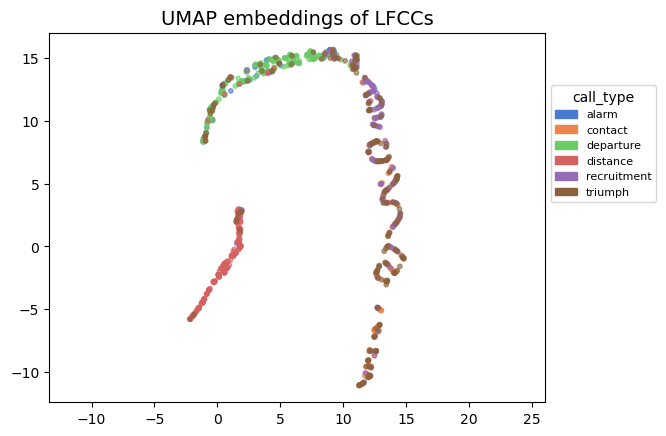

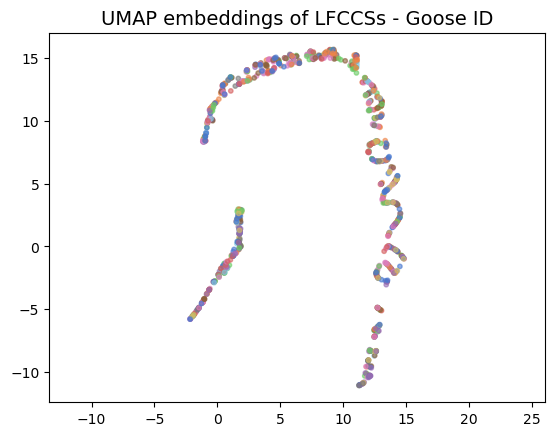

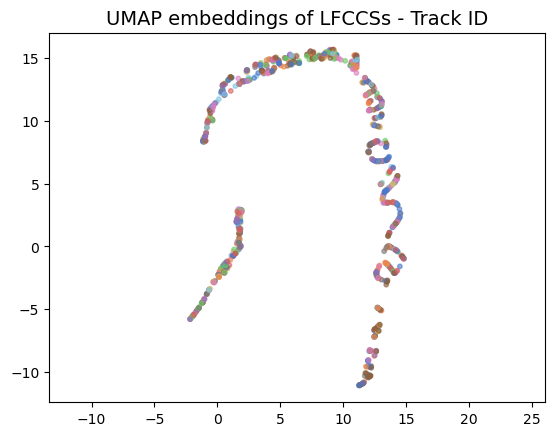

/Users/lenagies/Desktop/Master/Thesis/geese/code/GooseVocalizations/utils/plotting.py:436: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(


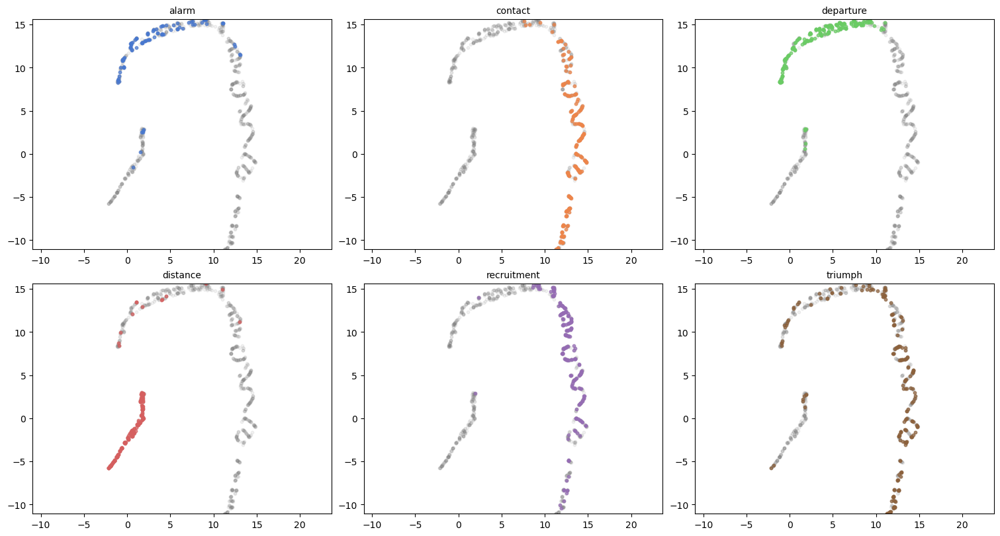

In [78]:
plotting.plot_embeddings_with_colorcoded_label(lfccs_df, embeddings_lfcc, "call_type", "UMAP embeddings of LFCCs")
plotting.plot_embeddings_with_colorcoded_label(lfccs_df, embeddings_lfcc, "goose_ID", "UMAP embeddings of LFCCSs - Goose ID", show_legend=False)
plotting.plot_embeddings_with_colorcoded_label(lfccs_df, embeddings_lfcc, "track_ID", "UMAP embeddings of LFCCSs - Track ID", show_legend=False)
plotting.plot_embedding_per_call_type(embeddings_lfcc, lfccs_df)

#### Embed spectrograms

##### UMAP

In [79]:
nn_results_spec = nearest_neighbors(
    spectrograms_scaled,
    n_neighbors=N_NEIGHBORS,
    metric=DISTANCE_METRIC,
    metric_kwds={},
    angular=False,
    random_state=RANDOM_SEED,
    verbose=True,
)
clusters_dict["Spectrograms"]["nn_graph"] = nn_results_spec

Thu Jan 30 12:17:13 2025 Finding Nearest Neighbors
Thu Jan 30 12:17:13 2025 Building RP forest with 7 trees
Thu Jan 30 12:17:13 2025 NN descent for 10 iterations
	 1  /  10
	 2  /  10
	 3  /  10
	Stopping threshold met -- exiting after 3 iterations
Thu Jan 30 12:17:13 2025 Finished Nearest Neighbor Search


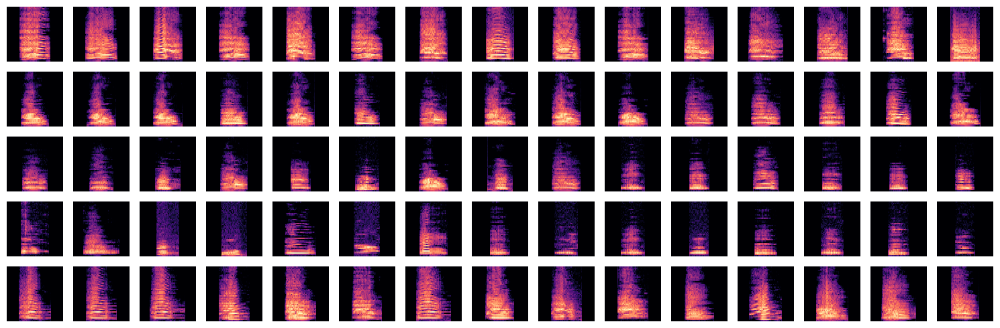

In [80]:
plotting.display_nearest_neighbours(nn_results_spec, calls_df)

In [81]:
embeddings_spec = umap.UMAP(precomputed_knn=nn_results_spec, n_neighbors=N_NEIGHBORS, n_components=2, min_dist=0.1, random_state=RANDOM_SEED).fit_transform(spectrograms_scaled)
clusters_dict["Spectrograms"]["embeddings"] = embeddings_spec

/Users/lenagies/anaconda3/envs/goose_vocalizations/lib/python3.11/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


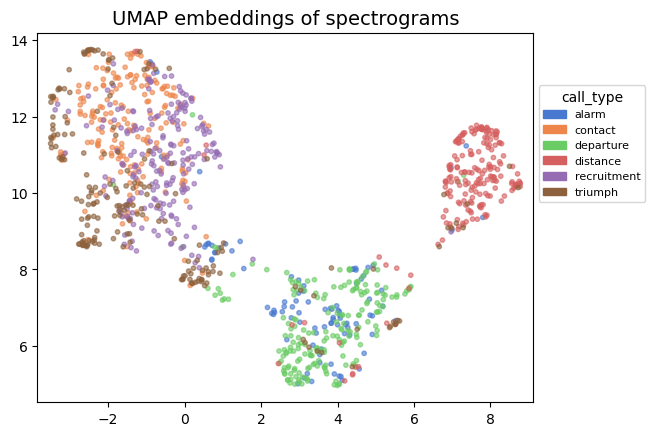

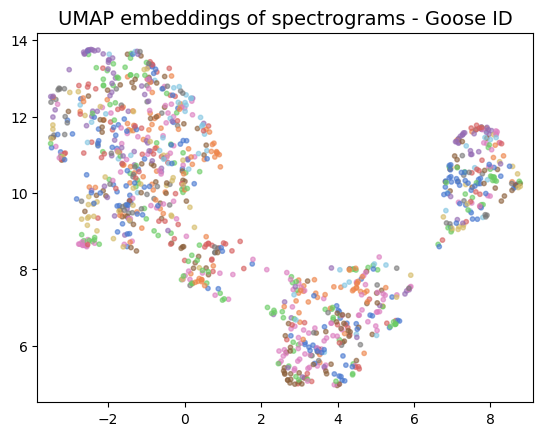

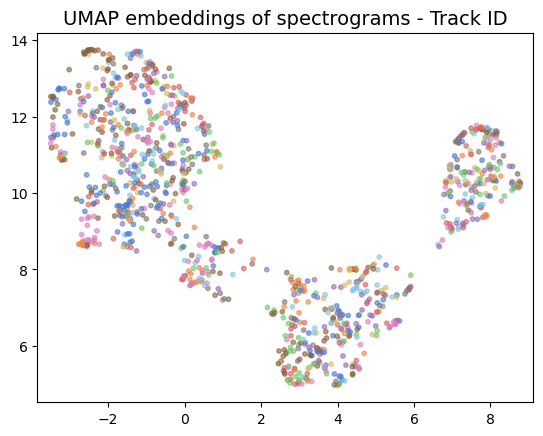

/Users/lenagies/Desktop/Master/Thesis/geese/code/GooseVocalizations/utils/plotting.py:436: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(


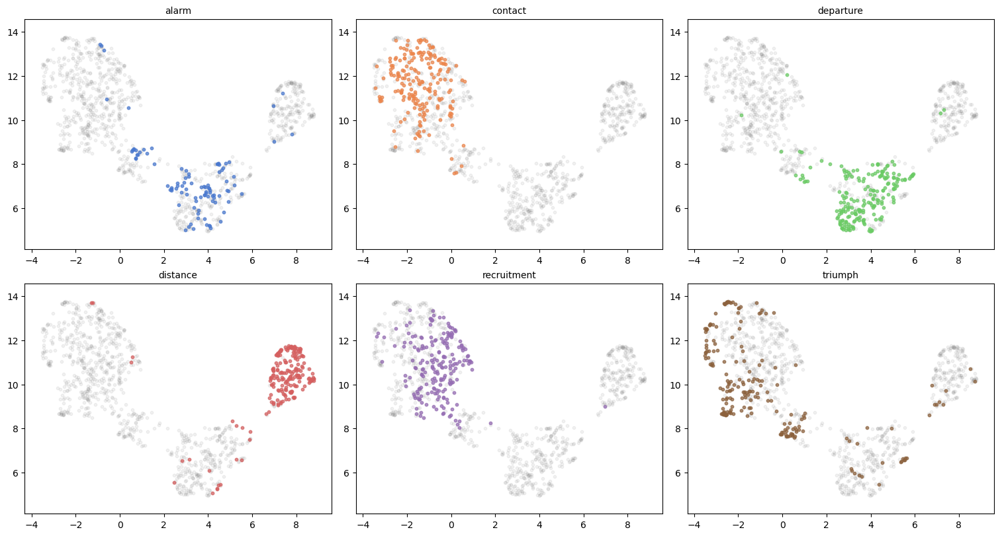

In [82]:
plotting.plot_embeddings_with_colorcoded_label(spectrograms_df, embeddings_spec, "call_type", "UMAP embeddings of spectrograms")
plotting.plot_embeddings_with_colorcoded_label(spectrograms_df, embeddings_spec, "goose_ID", "UMAP embeddings of spectrograms - Goose ID", show_legend=False)
plotting.plot_embeddings_with_colorcoded_label(spectrograms_df, embeddings_spec, "track_ID", "UMAP embeddings of spectrograms - Track ID", show_legend=False)
plotting.plot_embedding_per_call_type(embeddings_spec, spectrograms_df)

#### VAE embeddings

In [83]:
nn_results_vae = nearest_neighbors(
    vae_df.drop(columns=["call_type", "track_ID", "goose_ID"]),
    n_neighbors=N_NEIGHBORS,
    metric=DISTANCE_METRIC,
    metric_kwds={},
    angular=False,
    random_state=RANDOM_SEED,
    verbose=True,
)
clusters_dict["VAE representations"]["nn_graph"] = nn_results_vae

Thu Jan 30 12:17:21 2025 Finding Nearest Neighbors
Thu Jan 30 12:17:21 2025 Building RP forest with 7 trees
Thu Jan 30 12:17:21 2025 NN descent for 10 iterations
	 1  /  10
	 2  /  10
	 3  /  10
	Stopping threshold met -- exiting after 3 iterations
Thu Jan 30 12:17:21 2025 Finished Nearest Neighbor Search


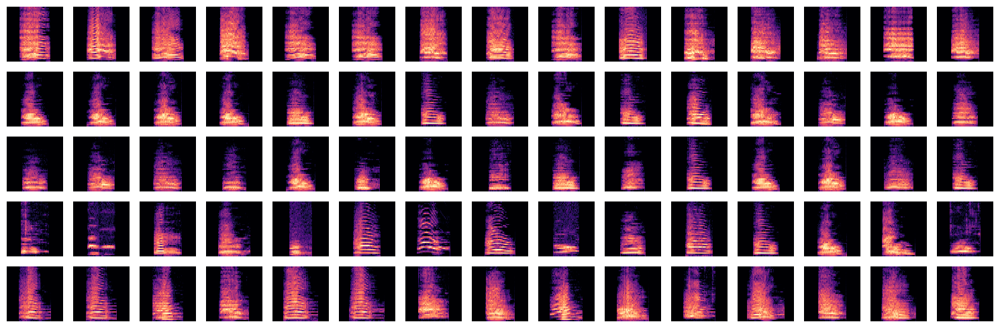

In [84]:
plotting.display_nearest_neighbours(nn_results_vae, calls_df)

In [85]:
embeddings_vae = umap.UMAP(precomputed_knn=nn_results_vae, n_neighbors=N_NEIGHBORS, n_components=2, min_dist=0.1, random_state=RANDOM_SEED).fit_transform(vae_df.drop(columns=["call_type", "track_ID", "goose_ID"]))
clusters_dict["VAE representations"]["embeddings"] = embeddings_vae

/Users/lenagies/anaconda3/envs/goose_vocalizations/lib/python3.11/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


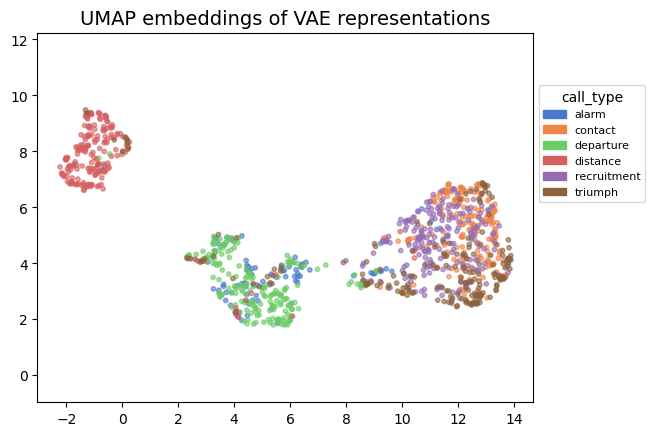

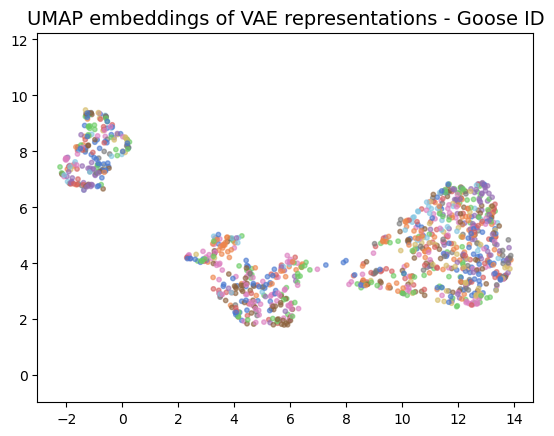

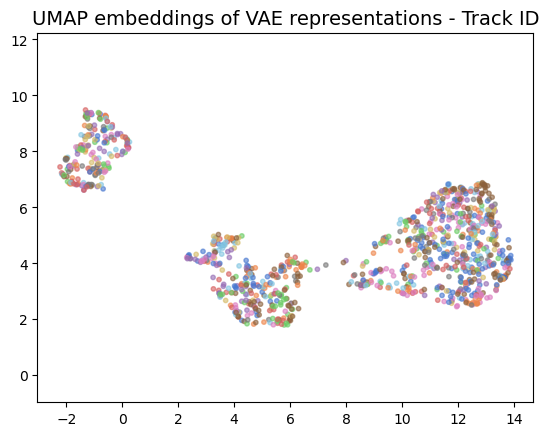

/Users/lenagies/Desktop/Master/Thesis/geese/code/GooseVocalizations/utils/plotting.py:436: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(


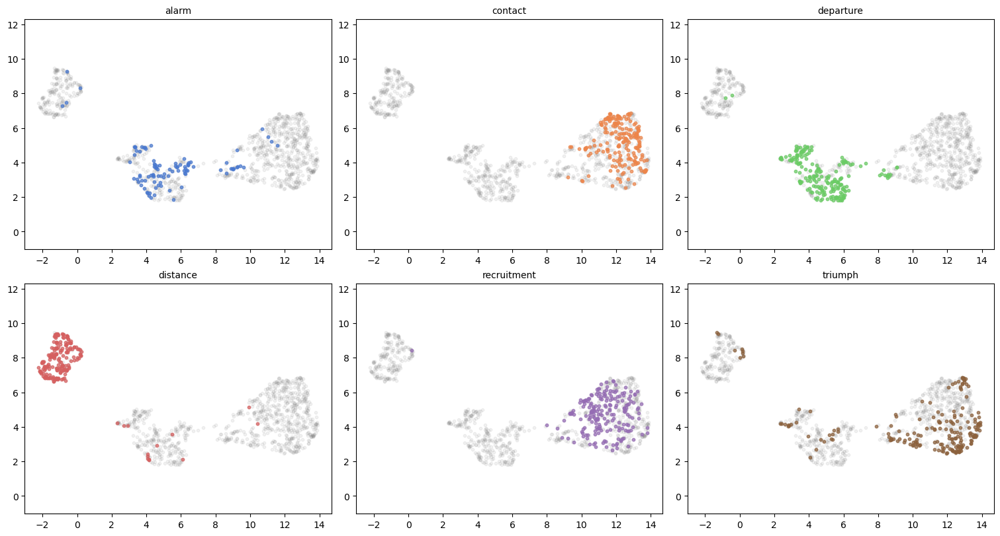

In [86]:
plotting.plot_embeddings_with_colorcoded_label(vae_df, embeddings_vae, "call_type", "UMAP embeddings of VAE representations")
plotting.plot_embeddings_with_colorcoded_label(vae_df, embeddings_vae, "goose_ID", "UMAP embeddings of VAE representations - Goose ID", show_legend=False)
plotting.plot_embeddings_with_colorcoded_label(vae_df, embeddings_vae, "track_ID", "UMAP embeddings of VAE representations - Track ID", show_legend=False)
plotting.plot_embedding_per_call_type(embeddings_vae, vae_df)

## Visualize acoustic features

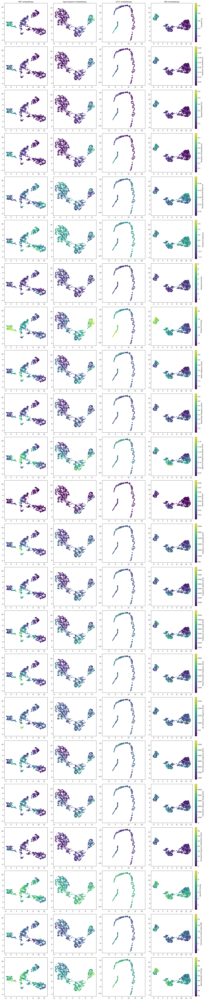

In [87]:
plotting.plot_colorcoded_features(
    feature_columns_list, 
    feature_titles_list, 
    [embeddings_paf, embeddings_spec, embeddings_lfcc, embeddings_vae], 
    ["PAF embeddings", "Spectrogram embeddings", "LFCC embeddings", "VAE embeddings"], 
    calls_df)

## Clustering

#### k-means

In [88]:
print("--------------PAF---------------")

print("\n--------PAF embeddings--------")
_, _, clusters_dict["PAFs"]["kMeans-preset"] = clustering.silhouette_analysis_kmeans(embeddings_paf, random_seeds, range_n_clusters=[6])

print("\n-------LFCC embeddings--------")
_, _, clusters_dict["LFCCs"]["kMeans-preset"] = clustering.silhouette_analysis_kmeans(embeddings_lfcc, random_seeds, range_n_clusters=[6])

print("\n----Spectrogram embeddings----")
_, _, clusters_dict["Spectrograms"]["kMeans-preset"] = clustering.silhouette_analysis_kmeans(embeddings_spec, random_seeds, range_n_clusters=[6])

print("\n----VAE representations embeddings----")
_, _, clusters_dict["VAE representations"]["kMeans-preset"] = clustering.silhouette_analysis_kmeans(embeddings_vae, random_seeds, range_n_clusters=[6])

--------------PAF---------------

--------PAF embeddings--------
For n_clusters = 6 The silhouette_score is: 0.56896263
best score with 6 clusters: 0.5689626336097717

-------LFCC embeddings--------
For n_clusters = 6 The silhouette_score is: 0.57985693
best score with 6 clusters: 0.5798569321632385

----Spectrogram embeddings----
For n_clusters = 6 The silhouette_score is: 0.43222734
best score with 6 clusters: 0.43222734332084656

----VAE representations embeddings----
For n_clusters = 6 The silhouette_score is: 0.51164514
best score with 6 clusters: 0.5116451382637024


In [89]:
print("--------------PAF---------------")

print("\n--------PAF embeddings--------")
_, _, clusters_dict["PAFs"]["kMeans"] = clustering.silhouette_analysis_kmeans(embeddings_paf, random_seeds)

print("\n-------LFCC embeddings--------")
_, _, clusters_dict["LFCCs"]["kMeans"] = clustering.silhouette_analysis_kmeans(embeddings_lfcc, random_seeds)

print("\n----Spectrogram embeddings----")
_, _, clusters_dict["Spectrograms"]["kMeans"] = clustering.silhouette_analysis_kmeans(embeddings_spec, random_seeds)

print("\n----VAE representations embeddings----")
_, _, clusters_dict["VAE representations"]["kMeans"] = clustering.silhouette_analysis_kmeans(embeddings_vae, random_seeds)

--------------PAF---------------

--------PAF embeddings--------
For n_clusters = 2 The silhouette_score is: 0.46749812
For n_clusters = 3 The silhouette_score is: 0.552884
For n_clusters = 4 The silhouette_score is: 0.6074937
For n_clusters = 5 The silhouette_score is: 0.6062428
For n_clusters = 6 The silhouette_score is: 0.56896263
For n_clusters = 7 The silhouette_score is: 0.5156695
For n_clusters = 8 The silhouette_score is: 0.5527767
For n_clusters = 9 The silhouette_score is: 0.53909343
For n_clusters = 10 The silhouette_score is: 0.511965
For n_clusters = 11 The silhouette_score is: 0.48371825
best score with 4 clusters: 0.6074936985969543

-------LFCC embeddings--------
For n_clusters = 2 The silhouette_score is: 0.4690416
For n_clusters = 3 The silhouette_score is: 0.4757625
For n_clusters = 4 The silhouette_score is: 0.5629357
For n_clusters = 5 The silhouette_score is: 0.5766476
For n_clusters = 6 The silhouette_score is: 0.57985693
For n_clusters = 7 The silhouette_score i

#### HDBSCAN

In [90]:
embeddings_paf.shape

(1096, 2)

--------------PAF---------------

--------PAF embeddings--------
For min_cluster_size=10, min_samples=1, n_clusters=3:                 average silhouette_score=0.40872177481651306
For min_cluster_size=10, min_samples=2, n_clusters=3:                 average silhouette_score=0.40872177481651306
For min_cluster_size=10, min_samples=3, n_clusters=3:                 average silhouette_score=0.40872177481651306
For min_cluster_size=10, min_samples=4, n_clusters=3:                 average silhouette_score=0.40872177481651306
For min_cluster_size=10, min_samples=5, n_clusters=3:                 average silhouette_score=0.40872177481651306
For min_cluster_size=10, min_samples=15, n_clusters=3:                 average silhouette_score=0.40872177481651306
For min_cluster_size=10, min_samples=25, n_clusters=3:                 average silhouette_score=0.30737367272377014

Best parameter combination: min_cluster_size=10, min_samples=1           with 3 clusters and silhouette score: 0.40872177481651

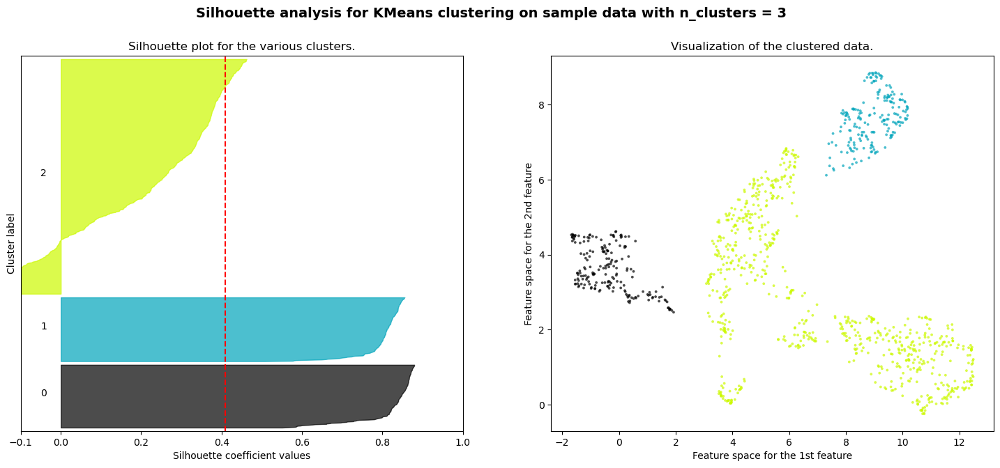

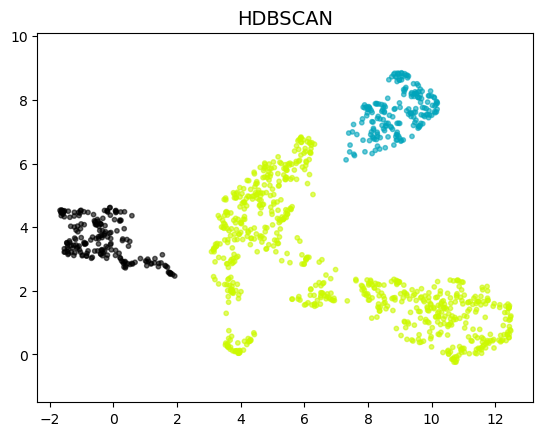


-------LFCC embeddings--------
For min_cluster_size=10, min_samples=1, n_clusters=7:                 average silhouette_score=0.3697349429130554
For min_cluster_size=10, min_samples=2, n_clusters=7:                 average silhouette_score=0.3697349429130554
For min_cluster_size=10, min_samples=3, n_clusters=7:                 average silhouette_score=0.3697349429130554
For min_cluster_size=10, min_samples=4, n_clusters=6:                 average silhouette_score=0.475944846868515
For min_cluster_size=10, min_samples=5, n_clusters=6:                 average silhouette_score=0.475944846868515
For min_cluster_size=10, min_samples=15, n_clusters=7:                 average silhouette_score=0.4384371340274811
For min_cluster_size=10, min_samples=25, n_clusters=3:                 average silhouette_score=0.4272371530532837

Best parameter combination: min_cluster_size=10, min_samples=4           with 6 clusters and silhouette score: 0.475944846868515


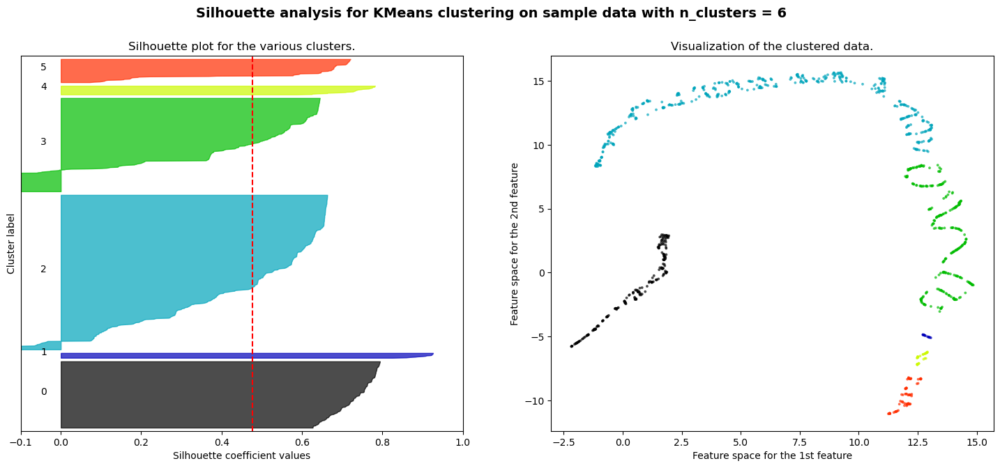

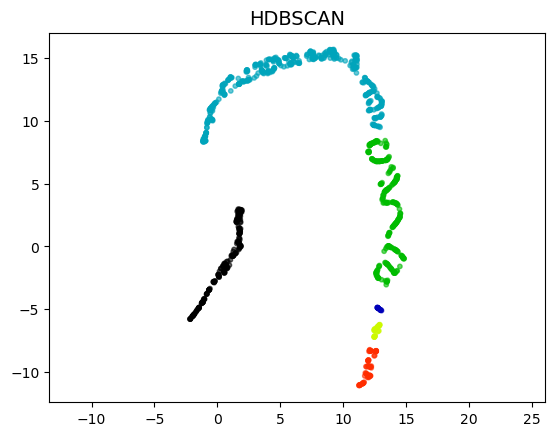


----Spectrogram embeddings----
For min_cluster_size=10, min_samples=1, n_clusters=2:                 average silhouette_score=0.477666974067688
For min_cluster_size=10, min_samples=2, n_clusters=2:                 average silhouette_score=0.477666974067688
For min_cluster_size=10, min_samples=3, n_clusters=2:                 average silhouette_score=0.477666974067688
For min_cluster_size=10, min_samples=4, n_clusters=3:                 average silhouette_score=0.6490514278411865
For min_cluster_size=10, min_samples=5, n_clusters=2:                 average silhouette_score=0.477666974067688
For min_cluster_size=10, min_samples=15, n_clusters=2:                 average silhouette_score=0.477666974067688
For min_cluster_size=10, min_samples=25, n_clusters=3:                 average silhouette_score=0.42504116892814636

Best parameter combination: min_cluster_size=10, min_samples=4           with 3 clusters and silhouette score: 0.6490514278411865


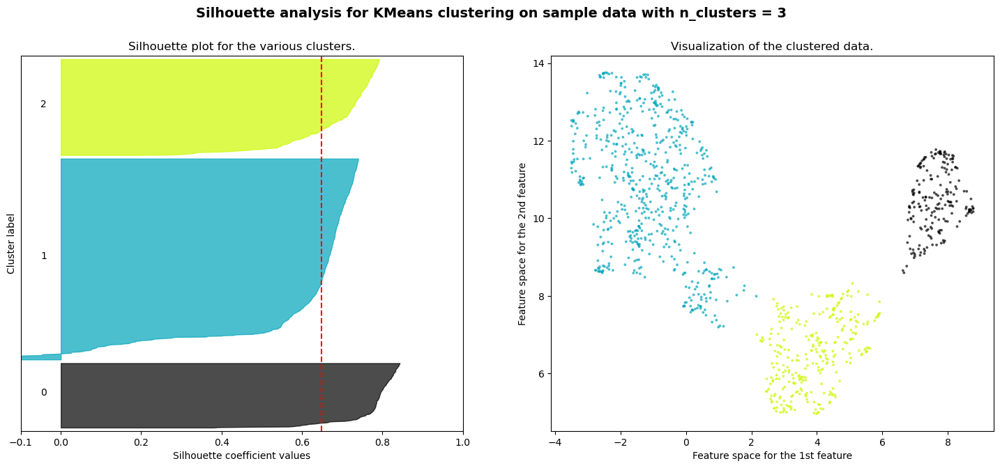

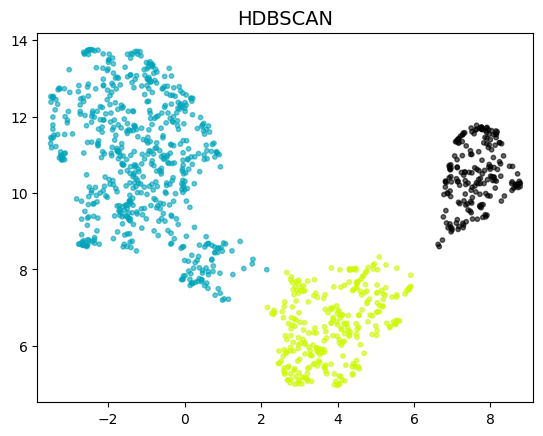


----VAE representations embeddings----
For min_cluster_size=10, min_samples=1, n_clusters=2:                 average silhouette_score=0.6052983403205872
For min_cluster_size=10, min_samples=2, n_clusters=2:                 average silhouette_score=0.6052983403205872
For min_cluster_size=10, min_samples=3, n_clusters=2:                 average silhouette_score=0.6052983403205872
For min_cluster_size=10, min_samples=4, n_clusters=2:                 average silhouette_score=0.6052983403205872
For min_cluster_size=10, min_samples=5, n_clusters=2:                 average silhouette_score=0.6052983403205872
For min_cluster_size=10, min_samples=15, n_clusters=2:                 average silhouette_score=0.6052983403205872
For min_cluster_size=10, min_samples=25, n_clusters=3:                 average silhouette_score=0.4836418032646179

Best parameter combination: min_cluster_size=10, min_samples=1           with 2 clusters and silhouette score: 0.6052983403205872


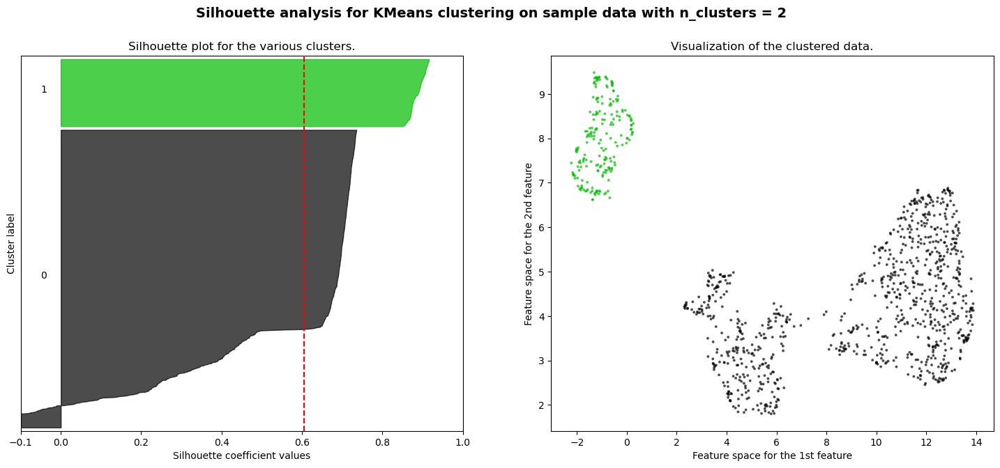

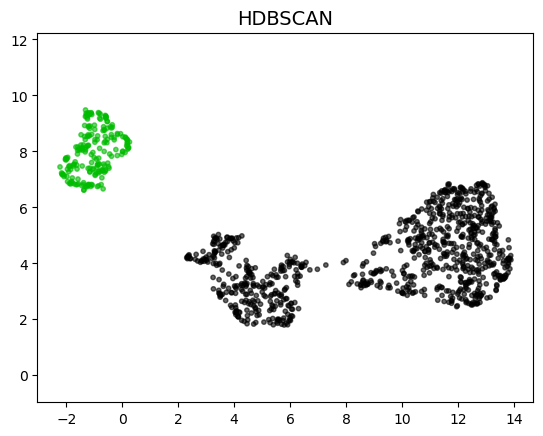

In [91]:
print("--------------PAF---------------")

print("\n--------PAF embeddings--------")
_, _, clusters_dict["PAFs"]["HDBSCAN"] = clustering.silhouette_analysis_hdbscan(embeddings_paf)

print("\n-------LFCC embeddings--------")
_, _, clusters_dict["LFCCs"]["HDBSCAN"] = clustering.silhouette_analysis_hdbscan(embeddings_lfcc)

print("\n----Spectrogram embeddings----")
_, _, clusters_dict["Spectrograms"]["HDBSCAN"] = clustering.silhouette_analysis_hdbscan(embeddings_spec)

print("\n----VAE representations embeddings----")
_, _, clusters_dict["VAE representations"]["HDBSCAN"] = clustering.silhouette_analysis_hdbscan(embeddings_vae)

#### Leiden clustering

--------------PAF---------------


100%|██████████| 1096/1096 [00:00<00:00, 154930.98it/s]


For resolution = 0.1 The average modularity is: 0.4671335682562757 N clusters: 2


100%|██████████| 1096/1096 [00:00<00:00, 215032.14it/s]


For resolution = 0.2 The average modularity is: 0.6888951445018707 N clusters: 5


100%|██████████| 1096/1096 [00:00<00:00, 182817.94it/s]


For resolution = 0.3 The average modularity is: 0.7133360770949382 N clusters: 5


100%|██████████| 1096/1096 [00:00<00:00, 167582.56it/s]


For resolution = 0.4 The average modularity is: 0.7144186365639282 N clusters: 5


100%|██████████| 1096/1096 [00:00<00:00, 186526.97it/s]


For resolution = 0.5 The average modularity is: 0.7142269473056418 N clusters: 5


100%|██████████| 1096/1096 [00:00<00:00, 208289.86it/s]


For resolution = 0.6 The average modularity is: 0.7148181403218887 N clusters: 5


100%|██████████| 1096/1096 [00:00<00:00, 224735.13it/s]


For resolution = 0.7 The average modularity is: 0.7292399123140251 N clusters: 7


100%|██████████| 1096/1096 [00:00<00:00, 220403.57it/s]


For resolution = 0.7999999999999999 The average modularity is: 0.7242967474931524 N clusters: 7


100%|██████████| 1096/1096 [00:00<00:00, 217720.81it/s]


For resolution = 0.8999999999999999 The average modularity is: 0.7356291012012589 N clusters: 9


100%|██████████| 1096/1096 [00:00<00:00, 197268.90it/s]


For resolution = 0.9999999999999999 The average modularity is: 0.7377368102023965 N clusters: 9


100%|██████████| 1096/1096 [00:00<00:00, 217504.48it/s]


For resolution = 1.0999999999999999 The average modularity is: 0.7329510008089762 N clusters: 10


100%|██████████| 1096/1096 [00:00<00:00, 201735.95it/s]


For resolution = 1.2 The average modularity is: 0.7367160142518167 N clusters: 10


100%|██████████| 1096/1096 [00:00<00:00, 202589.45it/s]


For resolution = 1.3 The average modularity is: 0.73155690329038 N clusters: 10


100%|██████████| 1096/1096 [00:00<00:00, 219205.44it/s]


For resolution = 1.4 The average modularity is: 0.7298349853271133 N clusters: 12


100%|██████████| 1096/1096 [00:00<00:00, 230066.42it/s]


For resolution = 1.5 The average modularity is: 0.7328832059873206 N clusters: 11


100%|██████████| 1096/1096 [00:00<00:00, 225087.26it/s]


For resolution = 1.5999999999999999 The average modularity is: 0.7341681220512872 N clusters: 11


100%|██████████| 1096/1096 [00:00<00:00, 204901.14it/s]


For resolution = 1.7 The average modularity is: 0.7268540689142485 N clusters: 14


100%|██████████| 1096/1096 [00:00<00:00, 195856.90it/s]


For resolution = 1.8 The average modularity is: 0.7197298680364441 N clusters: 13


100%|██████████| 1096/1096 [00:00<00:00, 186807.43it/s]


For resolution = 1.9 The average modularity is: 0.7118304025900014 N clusters: 16


100%|██████████| 1096/1096 [00:00<00:00, 222268.50it/s]


For resolution = 2.0 The average modularity is: 0.7128723866787776 N clusters: 17


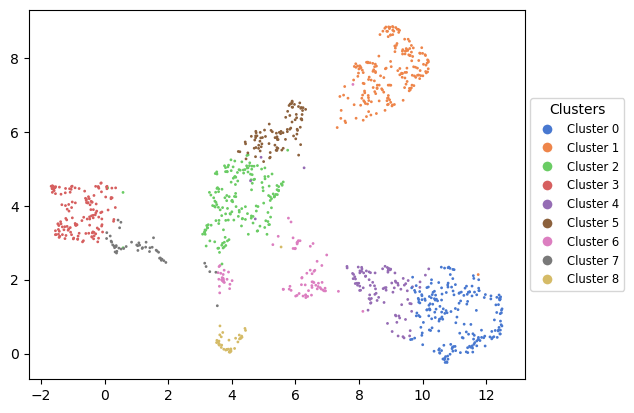

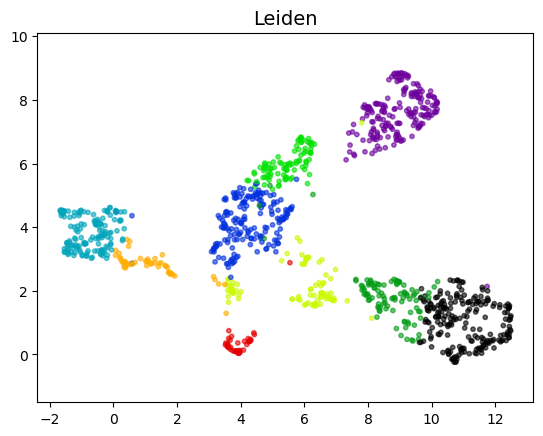

best score with 9 clusters and resolution parameter 0.9999999999999999: 0.7377368102023965

----LFCCs----


100%|██████████| 1096/1096 [00:00<00:00, 187607.93it/s]


For resolution = 0.1 The average modularity is: 0.7321337252400562 N clusters: 4


100%|██████████| 1096/1096 [00:00<00:00, 200285.69it/s]


For resolution = 0.2 The average modularity is: 0.8130534145467287 N clusters: 7


100%|██████████| 1096/1096 [00:00<00:00, 200617.84it/s]


For resolution = 0.3 The average modularity is: 0.8152516270757196 N clusters: 8


100%|██████████| 1096/1096 [00:00<00:00, 210937.33it/s]


For resolution = 0.4 The average modularity is: 0.8389142815722244 N clusters: 9


100%|██████████| 1096/1096 [00:00<00:00, 210647.35it/s]


For resolution = 0.5 The average modularity is: 0.8474254061156802 N clusters: 10


100%|██████████| 1096/1096 [00:00<00:00, 192922.49it/s]


For resolution = 0.6 The average modularity is: 0.8485403349945525 N clusters: 10


100%|██████████| 1096/1096 [00:00<00:00, 208289.86it/s]


For resolution = 0.7 The average modularity is: 0.8482893180998358 N clusters: 10


100%|██████████| 1096/1096 [00:00<00:00, 159883.04it/s]


For resolution = 0.7999999999999999 The average modularity is: 0.8534281604844506 N clusters: 10


100%|██████████| 1096/1096 [00:00<00:00, 186171.93it/s]


For resolution = 0.8999999999999999 The average modularity is: 0.8586364860308902 N clusters: 12


100%|██████████| 1096/1096 [00:00<00:00, 182542.08it/s]


For resolution = 0.9999999999999999 The average modularity is: 0.8601353668248829 N clusters: 14


100%|██████████| 1096/1096 [00:00<00:00, 184854.32it/s]


For resolution = 1.0999999999999999 The average modularity is: 0.8637193965726976 N clusters: 14


100%|██████████| 1096/1096 [00:00<00:00, 158134.06it/s]


For resolution = 1.2 The average modularity is: 0.86667036671547 N clusters: 16


100%|██████████| 1096/1096 [00:00<00:00, 211870.64it/s]


For resolution = 1.3 The average modularity is: 0.86667036671547 N clusters: 16


100%|██████████| 1096/1096 [00:00<00:00, 189588.70it/s]


For resolution = 1.4 The average modularity is: 0.8666447995113252 N clusters: 16


100%|██████████| 1096/1096 [00:00<00:00, 204363.71it/s]


For resolution = 1.5 The average modularity is: 0.8648285171366485 N clusters: 17


100%|██████████| 1096/1096 [00:00<00:00, 219236.80it/s]


For resolution = 1.5999999999999999 The average modularity is: 0.8668187197857192 N clusters: 16


100%|██████████| 1096/1096 [00:00<00:00, 192793.04it/s]


For resolution = 1.7 The average modularity is: 0.8645848503618374 N clusters: 17


100%|██████████| 1096/1096 [00:00<00:00, 193019.70it/s]


For resolution = 1.8 The average modularity is: 0.8617686033934593 N clusters: 18


100%|██████████| 1096/1096 [00:00<00:00, 206948.96it/s]


For resolution = 1.9 The average modularity is: 0.8609342787743793 N clusters: 19


100%|██████████| 1096/1096 [00:00<00:00, 203874.28it/s]


For resolution = 2.0 The average modularity is: 0.8609342787743793 N clusters: 19


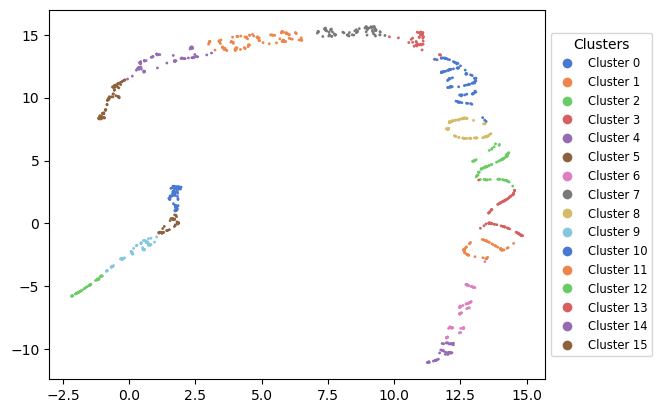

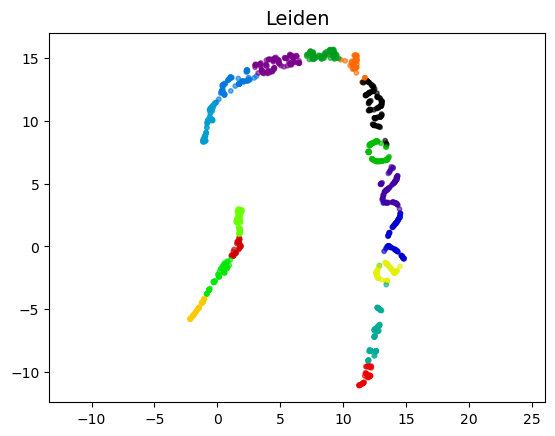

best score with 16 clusters and resolution parameter 1.5999999999999999: 0.8668187197857192

----Spectrograms----


100%|██████████| 1096/1096 [00:00<00:00, 190019.72it/s]


For resolution = 0.1 The average modularity is: 0.5678621259028944 N clusters: 3


100%|██████████| 1096/1096 [00:00<00:00, 202250.75it/s]


For resolution = 0.2 The average modularity is: 0.5678621259028944 N clusters: 3


100%|██████████| 1096/1096 [00:00<00:00, 198632.73it/s]


For resolution = 0.3 The average modularity is: 0.5678621259028944 N clusters: 3


100%|██████████| 1096/1096 [00:00<00:00, 200294.42it/s]


For resolution = 0.4 The average modularity is: 0.5678621259028944 N clusters: 3


100%|██████████| 1096/1096 [00:00<00:00, 199304.45it/s]


For resolution = 0.5 The average modularity is: 0.5678621259028944 N clusters: 3


100%|██████████| 1096/1096 [00:00<00:00, 179723.09it/s]


For resolution = 0.6 The average modularity is: 0.6581328794304764 N clusters: 4


100%|██████████| 1096/1096 [00:00<00:00, 206243.31it/s]


For resolution = 0.7 The average modularity is: 0.651967570820752 N clusters: 5


100%|██████████| 1096/1096 [00:00<00:00, 186073.96it/s]


For resolution = 0.7999999999999999 The average modularity is: 0.6966634206079336 N clusters: 7


100%|██████████| 1096/1096 [00:00<00:00, 201364.81it/s]


For resolution = 0.8999999999999999 The average modularity is: 0.6814663564390804 N clusters: 7


100%|██████████| 1096/1096 [00:00<00:00, 186549.68it/s]


For resolution = 0.9999999999999999 The average modularity is: 0.6917610945058665 N clusters: 8


100%|██████████| 1096/1096 [00:00<00:00, 198367.01it/s]


For resolution = 1.0999999999999999 The average modularity is: 0.6999956073423829 N clusters: 10


100%|██████████| 1096/1096 [00:00<00:00, 127885.08it/s]


For resolution = 1.2 The average modularity is: 0.7011988417213413 N clusters: 10


100%|██████████| 1096/1096 [00:00<00:00, 210329.30it/s]


For resolution = 1.3 The average modularity is: 0.6970001499670809 N clusters: 10


100%|██████████| 1096/1096 [00:00<00:00, 194918.47it/s]


For resolution = 1.4 The average modularity is: 0.6865802963371265 N clusters: 11


100%|██████████| 1096/1096 [00:00<00:00, 189753.04it/s]


For resolution = 1.5 The average modularity is: 0.6956267202805917 N clusters: 11


100%|██████████| 1096/1096 [00:00<00:00, 193157.58it/s]


For resolution = 1.5999999999999999 The average modularity is: 0.6867426530741366 N clusters: 14


100%|██████████| 1096/1096 [00:00<00:00, 194712.07it/s]


For resolution = 1.7 The average modularity is: 0.6827853833455567 N clusters: 15


100%|██████████| 1096/1096 [00:00<00:00, 205551.65it/s]


For resolution = 1.8 The average modularity is: 0.6783242619417764 N clusters: 17


100%|██████████| 1096/1096 [00:00<00:00, 207856.63it/s]


For resolution = 1.9 The average modularity is: 0.6791037080724186 N clusters: 17


100%|██████████| 1096/1096 [00:00<00:00, 177612.13it/s]


For resolution = 2.0 The average modularity is: 0.6721351615397075 N clusters: 18


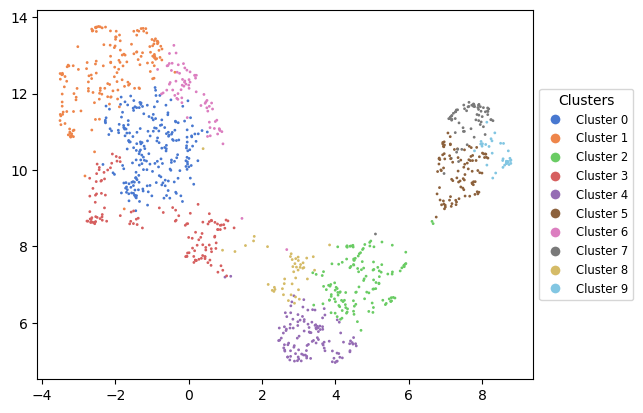

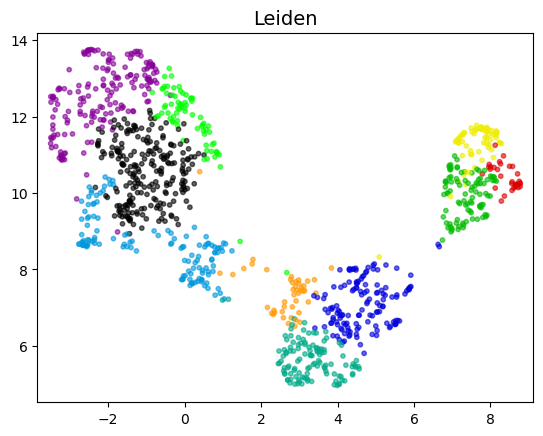

best score with 10 clusters and resolution parameter 1.2: 0.7011988417213413

----VAE representations----


100%|██████████| 1096/1096 [00:00<00:00, 154177.53it/s]


For resolution = 0.1 The average modularity is: 0.5789419251586962 N clusters: 3


100%|██████████| 1096/1096 [00:00<00:00, 195507.05it/s]


For resolution = 0.2 The average modularity is: 0.5789419251586962 N clusters: 3


100%|██████████| 1096/1096 [00:00<00:00, 201656.31it/s]


For resolution = 0.3 The average modularity is: 0.5789419251586962 N clusters: 3


100%|██████████| 1096/1096 [00:00<00:00, 198976.63it/s]


For resolution = 0.4 The average modularity is: 0.5919964346842818 N clusters: 3


100%|██████████| 1096/1096 [00:00<00:00, 195150.16it/s]


For resolution = 0.5 The average modularity is: 0.6691320100053715 N clusters: 4


100%|██████████| 1096/1096 [00:00<00:00, 169792.32it/s]


For resolution = 0.6 The average modularity is: 0.6981615389942272 N clusters: 5


100%|██████████| 1096/1096 [00:00<00:00, 177838.88it/s]


For resolution = 0.7 The average modularity is: 0.7115012442153854 N clusters: 6


100%|██████████| 1096/1096 [00:00<00:00, 216858.06it/s]


For resolution = 0.7999999999999999 The average modularity is: 0.7110341580056019 N clusters: 6


100%|██████████| 1096/1096 [00:00<00:00, 192542.71it/s]


For resolution = 0.8999999999999999 The average modularity is: 0.7118606206934796 N clusters: 8


100%|██████████| 1096/1096 [00:00<00:00, 195606.88it/s]


For resolution = 0.9999999999999999 The average modularity is: 0.7066406063114546 N clusters: 9


100%|██████████| 1096/1096 [00:00<00:00, 167710.95it/s]


For resolution = 1.0999999999999999 The average modularity is: 0.7139447056744403 N clusters: 9


100%|██████████| 1096/1096 [00:00<00:00, 164464.86it/s]


For resolution = 1.2 The average modularity is: 0.7073596672039001 N clusters: 10


100%|██████████| 1096/1096 [00:00<00:00, 161342.03it/s]


For resolution = 1.3 The average modularity is: 0.7048132446026121 N clusters: 10


100%|██████████| 1096/1096 [00:00<00:00, 190342.31it/s]


For resolution = 1.4 The average modularity is: 0.6989900340614027 N clusters: 12


100%|██████████| 1096/1096 [00:00<00:00, 178675.26it/s]


For resolution = 1.5 The average modularity is: 0.7037888447359735 N clusters: 11


100%|██████████| 1096/1096 [00:00<00:00, 194604.91it/s]


For resolution = 1.5999999999999999 The average modularity is: 0.6949743668762592 N clusters: 13


100%|██████████| 1096/1096 [00:00<00:00, 174583.46it/s]


For resolution = 1.7 The average modularity is: 0.6948854178955801 N clusters: 13


100%|██████████| 1096/1096 [00:00<00:00, 177838.88it/s]


For resolution = 1.8 The average modularity is: 0.6948659350871391 N clusters: 13


100%|██████████| 1096/1096 [00:00<00:00, 197829.20it/s]


For resolution = 1.9 The average modularity is: 0.6941488619763269 N clusters: 13


100%|██████████| 1096/1096 [00:00<00:00, 178384.06it/s]


For resolution = 2.0 The average modularity is: 0.6865714383914097 N clusters: 14


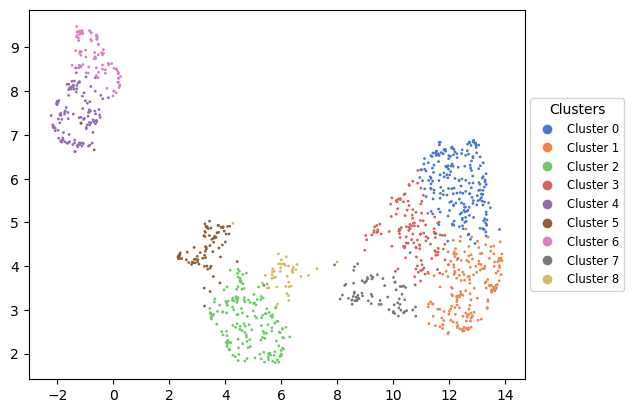

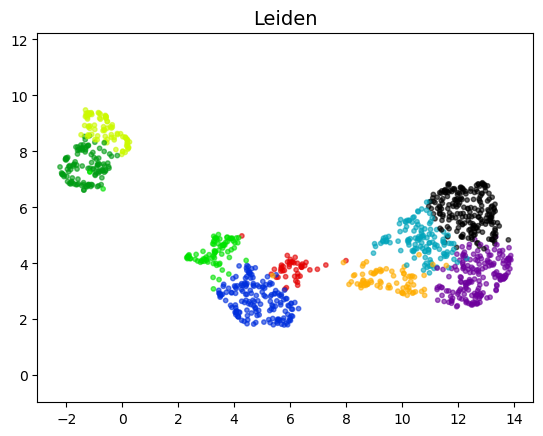

best score with 9 clusters and resolution parameter 1.0999999999999999: 0.7139447056744403


In [92]:
print("--------------PAF---------------")
_, _, clusters_dict["PAFs"]["Leiden"], partition_paf = clustering.modularity_analysis_leiden(nn_results_paf, calls_df, "leiden_cluster_paf", embeddings=embeddings_paf, plot_every_step=False, plot_best_clustering=True)

print("\n----LFCCs----")
_, _, clusters_dict["LFCCs"]["Leiden"], partition_lfcc = clustering.modularity_analysis_leiden(nn_results_lfcc, calls_df, "leiden_cluster_lfcc", embeddings=embeddings_lfcc, plot_every_step=False, plot_best_clustering=True)

print("\n----Spectrograms----")
_, _, clusters_dict["Spectrograms"]["Leiden"], partition_spectrogram = clustering.modularity_analysis_leiden(nn_results_spec, calls_df, "leiden_cluster_spectrogram", embeddings=embeddings_spec, plot_every_step=False, plot_best_clustering=True)

print("\n----VAE representations----")
_, _, clusters_dict["VAE representations"]["Leiden"], partition_vae = clustering.modularity_analysis_leiden(nn_results_vae, calls_df, "leiden_cluster_vae", embeddings=embeddings_vae, plot_every_step=False, plot_best_clustering=True)

clusters_dict["PAFs"]["Modularity"] = partition_paf.modularity
clusters_dict["LFCCs"]["Modularity"] = partition_lfcc.modularity
clusters_dict["Spectrograms"]["Modularity"] = partition_spectrogram.modularity
clusters_dict["VAE representations"]["Modularity"] = partition_vae.modularity

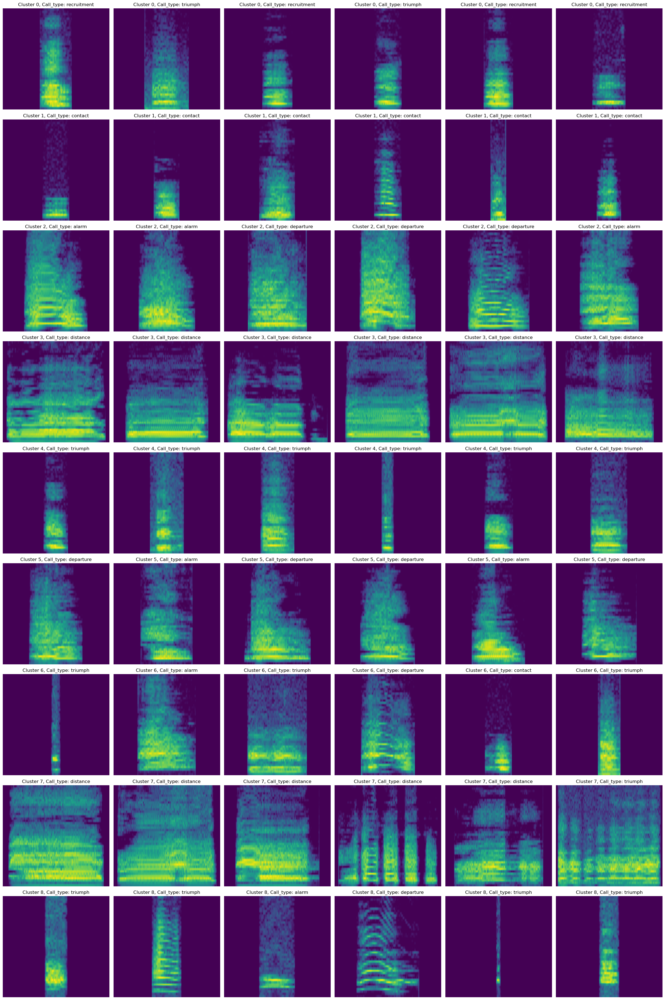

In [93]:
plotting.plot_cluster_examples("leiden_cluster_paf", np.unique(clusters_dict["PAFs"]["Leiden"]), calls_df)

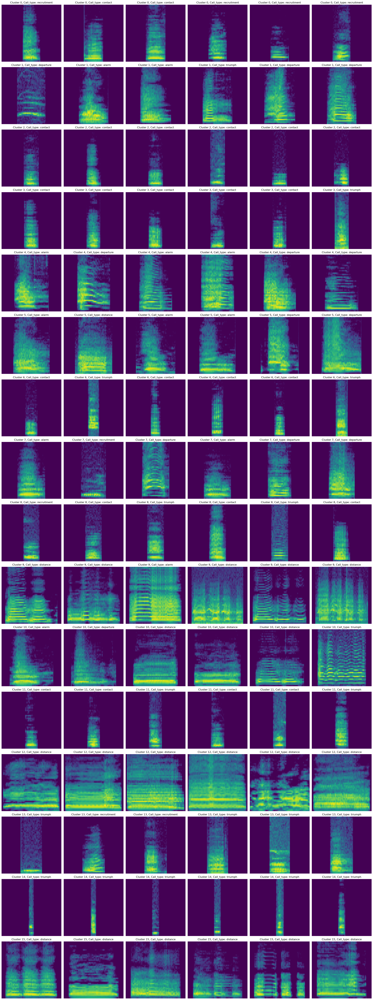

In [94]:
plotting.plot_cluster_examples("leiden_cluster_lfcc", np.unique(clusters_dict["LFCCs"]["Leiden"]), calls_df)

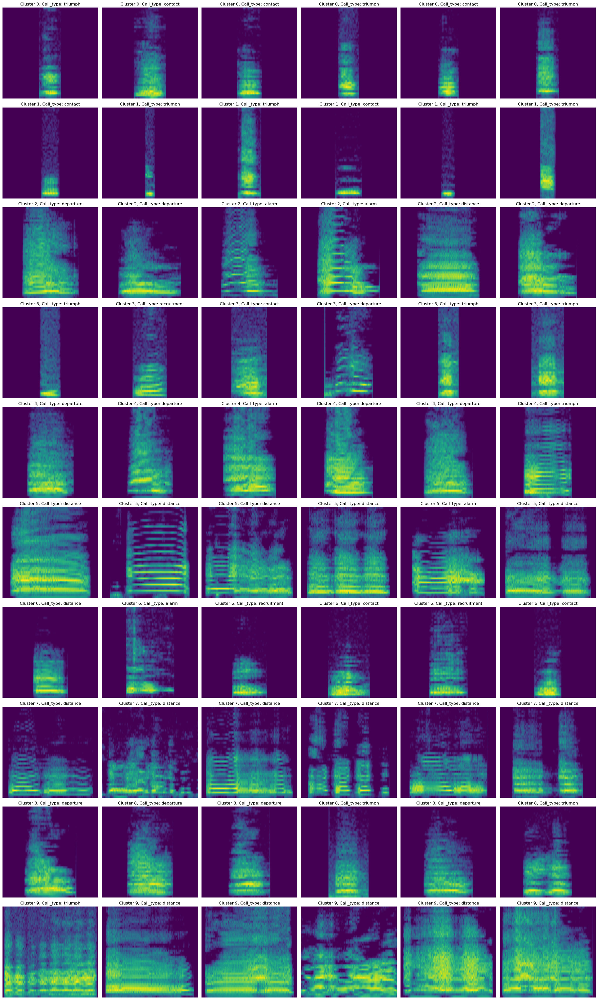

In [95]:
plotting.plot_cluster_examples("leiden_cluster_spectrogram", np.unique(clusters_dict["Spectrograms"]["Leiden"]), calls_df)

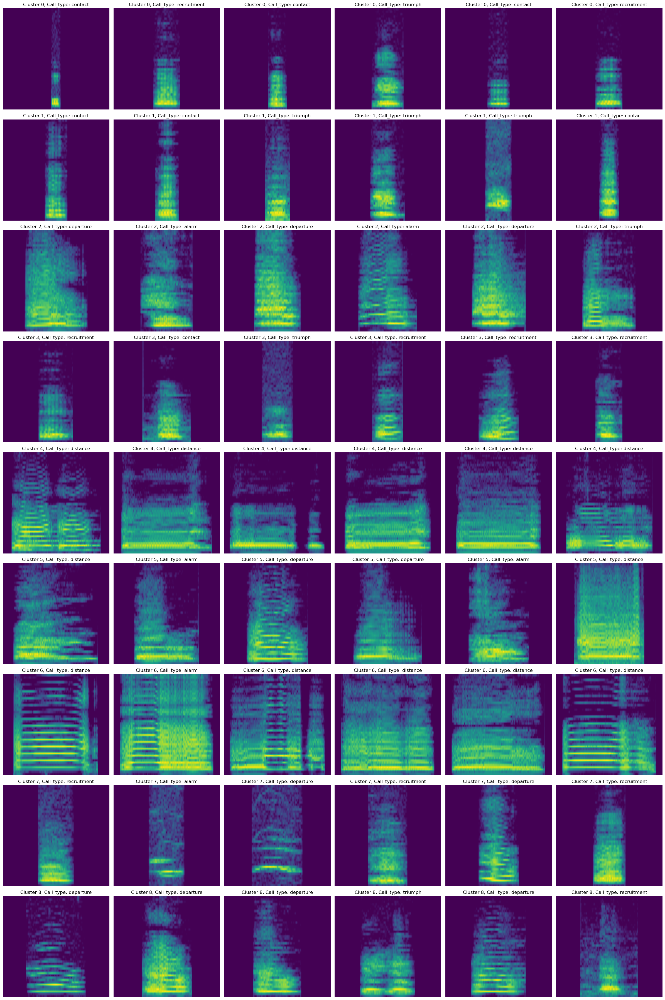

In [96]:
plotting.plot_cluster_examples("leiden_cluster_vae", np.unique(clusters_dict["VAE representations"]["Leiden"]), calls_df)

## Export cluster labels, Neirest Neighbour graphs and empeddings

In [97]:
# export clusters_dict
clusters_dict["PAFs"]["dataset"] = paf_scaled
clusters_dict["LFCCs"]["dataset"] = lfccs_scaled
clusters_dict["Spectrograms"]["dataset"] = spectrograms_scaled
clusters_dict["VAE representations"]["dataset"] = vae_df.drop(columns=["call_type", "track_ID", "goose_ID"])

with open(f"nn_graphs_embeddings_and_nn_graphs_{SUBSET_SIZE}.pkl", "wb") as file:
    pickle.dump(clusters_dict, file, protocol=pickle.HIGHEST_PROTOCOL)

Thu Jan 30 12:18:16 2025 Worst tree score: 0.87591241
Thu Jan 30 12:18:16 2025 Mean tree score: 0.88764338
Thu Jan 30 12:18:16 2025 Best tree score: 0.89507299
Thu Jan 30 12:18:16 2025 Forward diversification reduced edges from 16440 to 5567
Thu Jan 30 12:18:16 2025 Reverse diversification reduced edges from 5567 to 5567
Thu Jan 30 12:18:16 2025 Degree pruning reduced edges from 5642 to 5642
Thu Jan 30 12:18:16 2025 Resorting data and graph based on tree order
Thu Jan 30 12:18:16 2025 Building and compiling search function
Thu Jan 30 12:18:17 2025 Worst tree score: 0.97536496
Thu Jan 30 12:18:17 2025 Mean tree score: 0.98162148
Thu Jan 30 12:18:17 2025 Best tree score: 0.98813869
Thu Jan 30 12:18:17 2025 Forward diversification reduced edges from 16440 to 4577
Thu Jan 30 12:18:17 2025 Reverse diversification reduced edges from 4577 to 4577
Thu Jan 30 12:18:17 2025 Degree pruning reduced edges from 4138 to 4138
Thu Jan 30 12:18:17 2025 Resorting data and graph based on tree order
Thu Ja

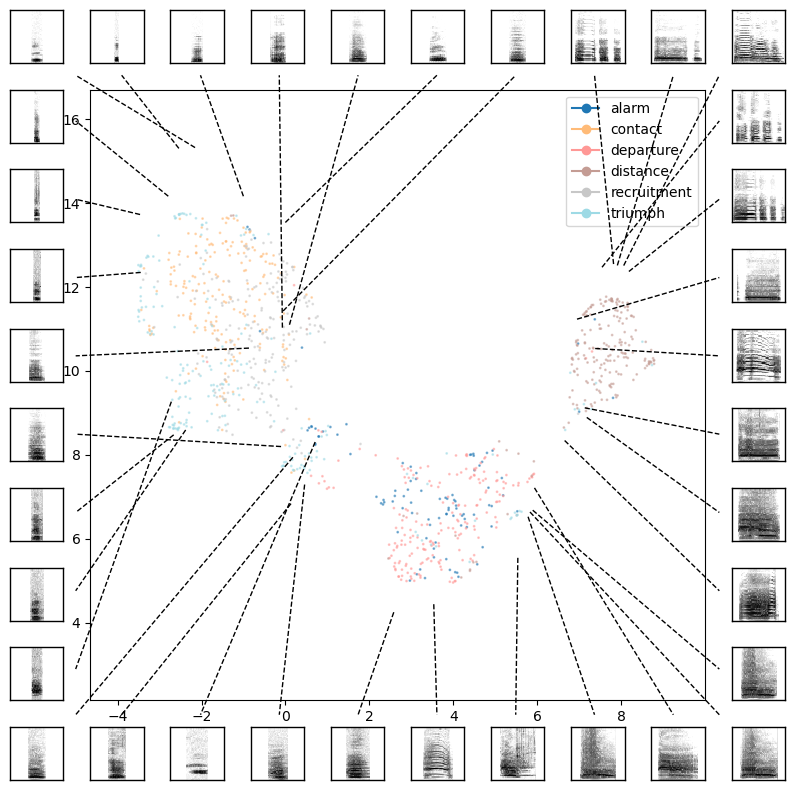

In [98]:
plotting.scatter_spec(embeddings_spec, calls_df["log_padded_spectrogram"], scatter_kwargs={"alpha": 0.5, "s": 1, "labels": calls_df["call_type"]})